In [1]:
%pip install rebound

Note: you may need to restart the kernel to use updated packages.


In [188]:
a= [ 0.0677, 0.1189, 0.1662 , 0.2138, 0.2535] #au

In [189]:
import rebound
import numpy as np
import astropy.units as u
import matplotlib.pyplot as plt

In [197]:
mass_earth = 3e-6 #solar masses
start_x = [0.06769998,  1.18900000e-01  , 0.1662    , 0.2138    , 0.2535]
start_y = [5.01579636e-05,0,  3.76400590e-05, 1.23601018e-05, 2.72122722e-06]
v0x = np.array( [0.07462658395619551, 0.05659626765330703, 0.04790208125104128, 0.04224355397579091, 0.03884847500678671])
v0x= [0.0746266044379049,0.05659626765330703,0.04790208247950675,0.042243554046383504,0.038848475009025]
v0y = np.array([5.52897859478072e-05, 0.0, 1.0848599329982713e-05, 2.4421638303104e-06, 4.170237775156792e-07])
P = [ 5.7,  13.2,21.8,31.8, 41]
v0y = np.zeros(5)

theta = [0.000740885792975013, 0, 0.00022647448422232177, 5.781151436712105e-05, 1.073462413715875e-05]

In [212]:
kep33 = rebound.Simulation() # This sets up our system
# kep33.integrator = 'whfast'

# hmmm what units?
# star = kep33.add(m=1.29,x=0,y=0,z=0) #star
# kepb = kep33.add(m=3.68*mass_earth,x = start_x[0] , y =  start_y[0], z = 0, vx = v0x[0],vy= v0y[0], P =P[0],a=a[0]) #closest
# kepc = kep33.add(m=0.39*mass_earth,x = start_x[1] , y =start_y[1],z = 0 ,vx = v0x[1], vy = v0y[1], P=P[1],a=a[1])
# kepd = kep33.add(m=3.91*mass_earth,x = start_x[2] , y = start_y[2] ,z = 0 ,vx = v0x[2],vy = v0y[2],P=P[2],a=a[2])
# kepe = kep33.add(m=5.57*mass_earth,x = start_x[3], y = start_y[3] ,z = 0,vx = v0x[3], vy= v0y[3],P=P[3],a=a[3])
# kepf = kep33.add(m=9.6*mass_earth, x = start_x[4] , y = start_y[4] ,z = 0,vx = v0x[4], vy= v0y[4],P=P[4],a=a[4]) #farthest




# star = kep33.add(m=1.29)#,x=0,y=0,z=0) #star
# kepb = kep33.add(m=3.68*mass_earth,a=a[0], f=theta[0]) #closest
# kepc = kep33.add(m=0.39*mass_earth,a=a[1], f= theta[1])
# kepd = kep33.add(m=3.91*mass_earth,a=a[2], f= theta[2])
# kepe = kep33.add(m=5.57*mass_earth,a=a[3],f= theta[3])
# kepf = kep33.add(m=9.6*mass_earth, a=a[4], f= theta[4]) #farthest

star = kep33.add(m=1.29)#,x=0,y=0,z=0) #star
kepb = kep33.add(m=3.68*mass_earth,P=P[0]) #closest
kepc = kep33.add(m=0.39*mass_earth,P=P[1])
kepd = kep33.add(m=3.91*mass_earth,P=P[2])
kepe = kep33.add(m=5.57*mass_earth,P=P[3])
kepf = kep33.add(m=9.6*mass_earth, P=P[4])#farthest



kep33.move_to_com() # Moving our system to the centre of mass frame, which should be in the star.

In [213]:
print(3.68*mass_earth)

1.1040000000000001e-05


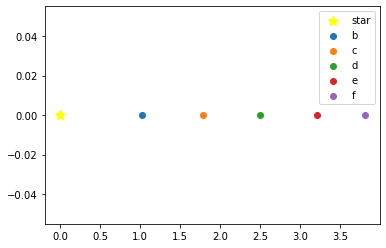

In [214]:
plt.scatter(kep33.particles[0].x,kep33.particles[0].y, label = 'star',s=100,marker =(5,1),color = 'yellow')
plt.scatter(kep33.particles[1].x,kep33.particles[1].y, label = 'b')
plt.scatter(kep33.particles[2].x,kep33.particles[2].y, label = 'c')
plt.scatter(kep33.particles[3].x,kep33.particles[3].y, label = 'd')
plt.scatter(kep33.particles[4].x,kep33.particles[4].y, label = 'e')
plt.scatter(kep33.particles[5].x,kep33.particles[5].y, label = 'f')
plt.legend()


In [215]:

times = np.arange(0,200,0.01) # 30 randomly spaced observations
N = len(times) 

p1,p2,p3,p4,p5 = np.zeros((N,2)), np.zeros((N,2)),np.zeros((N,2)),np.zeros((N,2)),np.zeros((N,2))

for i, t in enumerate(times):
    kep33.integrate(times[i])
    
    p1[i] = np.array([kep33.particles[1].x, kep33.particles[1].y])
    p2[i] = np.array([kep33.particles[2].x, kep33.particles[2].y])
    p3[i] = np.array([kep33.particles[3].x, kep33.particles[3].y])
    p4[i] = np.array([kep33.particles[4].x, kep33.particles[4].y])
    p5[i] = np.array([kep33.particles[5].x, kep33.particles[5].y])

        


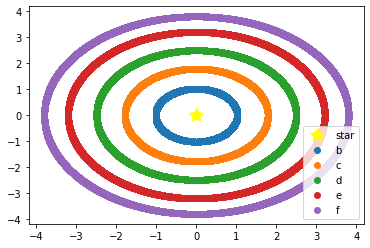

In [216]:
plt.scatter(kep33.particles[0].x,kep33.particles[0].y, label = 'star',s=200,marker =(5,1),color = 'yellow')
plt.scatter(p1[:, 0], p1[:, 1], label = 'b')
plt.scatter(p2[:, 0], p2[:, 1], label = 'c')
plt.scatter(p3[:, 0], p3[:, 1], label = 'd')
plt.scatter(p4[:, 0], p4[:, 1], label = 'e')
plt.scatter(p5[:, 0], p5[:, 1], label = 'f')
plt.legend()


plt.show()


In [217]:
print(times)

[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.9997e+02 1.9998e+02 1.9999e+02]


Animation size has reached 21006266 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


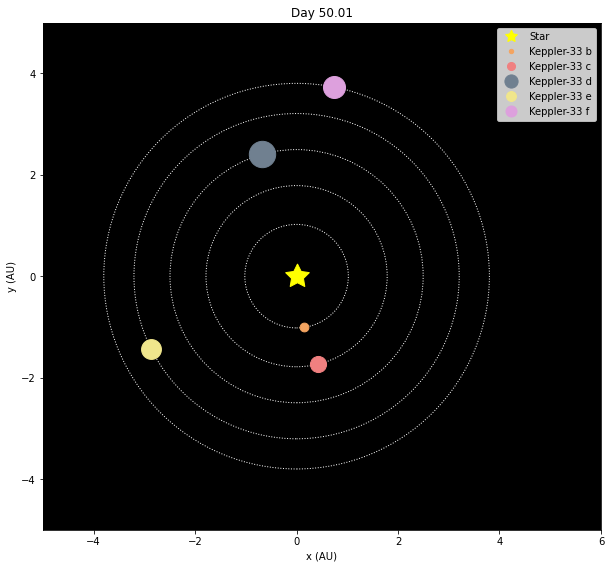

In [222]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import rebound

earth_radius = 4.258756e-5
jupiter_radius = 4.676e-4 

# Create a list of planets with their colors and names for visualization
planet_properties = [
    {'color': 'sandybrown', 'name': 'Keppler-33 b','radius': 1.74*earth_radius},
    {'color': 'lightcoral', 'name': 'Keppler-33 c','radius': 3.2*earth_radius},
    {'color': 'slategray', 'name': 'Keppler-33 d','radius': 0.477*jupiter_radius},
    {'color': 'khaki', 'name': 'Keppler-33 e','radius': 0.359*jupiter_radius},
    {'color': 'plum', 'name': 'Keppler-33 f','radius': 0.398*jupiter_radius},
]

sun = 0.008464 

planets_positions = [p1,p2,p3,p4,p5]


# Create a figure for plotting
fig, ax = plt.subplots(figsize=(10, 10))  # Increase size here
ax.set_xlim(-5,6)
ax.set_ylim(-5,5)

# ax.set_xlim(-0.3, 0.3)
# ax.set_ylim(-0.3, 0.3)
ax.set_aspect('equal')
ax.set_xlabel('x (AU)')
ax.set_ylabel('y (AU)')


# Plotting function to update positions
call_counter = 0
def update(frame):
    global call_counter 
        
    call_counter += 1

    # Clear the previous plot
    ax.clear()
    
    # Re-draw the axes
    ax.set_xlim(-5,6)
    ax.set_ylim(-5,5)
#     ax.set_xlim(-0.3, 0.5)
#     ax.set_ylim(-0.3, 0.3)
    ax.set_aspect('equal')
    ax.set_xlabel('x (AU)')
    ax.set_ylabel('y (AU)')
    
    ax.plot(0, 0, marker=(5,1), color='yellow', markersize=25, label='Star',linestyle='None')  # Sun at the center
    ax.set_facecolor('black')

    
    # Plot the orbits as grey dotted lines
    for i, planet in enumerate(planets_positions):
        # Calculate the distance from the Sun (Euclidean distance)
        x, y = planet[frame, 0], planet[frame, 1]  # Current position of the planet
        orbit_radius = np.sqrt(x**2 + y**2)
        
        # Plot the orbit as a grey dotted circle
        orbit = plt.Circle((0, 0), orbit_radius, color='white', linestyle=':', fill=False)
        ax.add_artist(orbit)
    
    
    # Update the positions of each planet
    for i, planet in enumerate(planets_positions): 
        x, y = planet[:,0][call_counter-1],planet[:,1][call_counter-1]
        ax.plot(x, y, marker='o', color=planet_properties[i]['color'], label=planet_properties[i]['name'], linestyle='None',
               markersize = (planet_properties[i]['radius']/sun)*1000)
    
    # Add legend and title
    ax.legend(loc='upper right',markerscale = 1/2)
    ax.set_title(f"Day {times[call_counter]}")

# Create an animation object
ani = FuncAnimation(fig, update, frames=np.arange(0, 2000, 1), interval=50, repeat=False)
#ani.save('planetary_orbits.mp4', writer='pillow', fps=30)  # Save the animation to a video file

# Display the animation inline in a Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


In [183]:
import plotly.graph_objects as go
import numpy as np

# Example planet positions (replace with actual data)
# Generating random example positions for demonstration
planets_positions = [p1,p2,p3,p4,p5]

planet_names = ['Keppler-33 b', 'Keppler-33 c', 'Keppler-33 d', 'Keppler-33 e', 'Keppler-33 f']
planet_colors = ['sandybrown', 'lightcoral', 'slategray', 'khaki', 'plum']
planet_radii = [3.1e-5, 4.2e-5, 2.8e-5, 1.5e-4, 5.3e-5]  # Example planet radii in AU

# Create a Plotly figure
fig = go.Figure()

# Loop through each planet and add it to the figure
for i, name in enumerate(planet_names):
    # For simplicity, we use the positions at a single time step (index 0)
    x = planet_positions[i, 0, 0]
    y = planet_positions[i, 0, 1]
    radius = planet_radii[i]
    
    # Scale the size based on planet radius, choose an appropriate scaling factor
    scaling_factor = 8e5  # Adjust this factor to control the size of the markers
    marker_size = radius * scaling_factor  # Scale marker size for visibility
    
    # Add the planet as a scatter point
    fig.add_trace(go.Scatter(x=[x],y=[y],mode='markers',marker=dict(size=marker_size,color=planet_colors[i],opacity=1),
                             name=name))

# Add the Sun (at the center)
fig.add_trace(go.Scatter(x=[0], y=[0],  mode='markers',marker=dict(size=50, color='yellow',opacity=1),name='Star'))

# Update layout for better presentation
fig.update_layout(
    title='Planetary Orbits',
    xaxis_title="x (AU)",
    yaxis_title="y (AU)",
    plot_bgcolor='black',  # Background color of the plot
    paper_bgcolor='black',  # Background color of the entire figure
    font=dict(color='white'),  # Change font color to white
    showlegend=True,  # Show the legend
    legend=dict(
        x=1.05,  # Position the legend outside of the plot area
        y=0.5,
        traceorder='normal',
        font=dict(family="sans-serif", size=12, color="white"),
        bgcolor='rgba(0, 0, 0, 0.7)',
        bordercolor='white',
        borderwidth=2
    ),
    dragmode='pan',  # Enable panning
    hovermode='closest',  # Show hover information
)

# Show the plot
fig.show()


In [186]:
import plotly.graph_objects as go
import numpy as np


planets_positions = [p1,p2,p3,p4,p5]


# Create a Plotly figure for 3D plot
fig = go.Figure()

# Add the Sun (at the center, you can adjust size for better visibility)
fig.add_trace(go.Scatter3d(
    x=[0], y=[0], z=[0],
    mode='markers',
    marker=dict(
        size=30,  # Adjust size of the Sun for visibility
        color='yellow',
        opacity=1
    ),
    name='Sun'
))

# Loop through each planet and add it to the figure
for i, name in enumerate(planet_names):
    # For simplicity, we use the positions at a single time step (index 0)
    x = planet_positions[i, 0, 0]
    y = planet_positions[i, 0, 1]
    z = 0
    radius = planet_radii[i]
    
     # Scale the size based on planet radius, choose an appropriate scaling factor
    scaling_factor = 8e5  # Adjust this factor to control the size of the markers
    marker_size = radius * scaling_factor  # Scale marker size for visibility
    
    # Add the planet as a scatter point
    fig.add_trace(go.Scatter3d(
        x=[x], 
        y=[y], 
        z=[z], 
        mode='markers',
        marker=dict(
            size=marker_size,
            color=planet_colors[i],
            opacity=0.8
        ),
        name=name
    ))

# Update layout for better presentation
fig.update_layout(
    title='3D Planetary Orbits',
    scene=dict(
        xaxis_title="x (AU)",
        yaxis_title="y (AU)",
        zaxis_title="z (AU)",
        xaxis=dict(range=[-0.3, 0.3]),
        yaxis=dict(range=[-0.3, 0.3]),
        zaxis=dict(range=[-0.3, 0.3])
    ),
    plot_bgcolor='black',  # Background color of the plot
    paper_bgcolor='black',  # Background color of the entire figure
    font=dict(color='white'),  # Change font color to white
    showlegend=True,  # Show the legend
    legend=dict(
        x=1.05,  # Position the legend outside of the plot area
        y=0.5,
        traceorder='normal',
        font=dict(family="sans-serif", size=12, color="white"),
        bgcolor='rgba(0, 0, 0, 0.7)',
        bordercolor='white',
        borderwidth=2
    ),
    dragmode='orbit',  # Allow orbiting of the 3D plot
    hovermode='closest',  # Show hover information
)

# Show the plot
fig.show()
